In [67]:
import scanpy as sc
import numpy as np
import pandas as pd
import scipy
import matplotlib.pyplot as plt
import anndata as ann
import seaborn as sns
from matplotlib.patches import Rectangle
import json
from shapely.geometry import Polygon

In [ ]:
from glob import glob
import PIL
PIL.Image.MAX_IMAGE_PIXELS = None
from PIL import Image
import cv2 as cv

In [69]:
from thor.pl import *
from thor.plotting._utils import *
from thor.utils import *
from thor.analysis import *

## Semi-supervised Annotation

In [ ]:
SIZE = 200

In [ ]:
genes = ['FBLN2', 'MEF2A']

In [ ]:
sc.set_figure_params(dpi=150)

In [70]:
def read_data(sn):
    ad = sc.read_h5ad('./data/HF/results_n5_g1_allgenes_prob/' + sn +'/'+ sn+'_fineST_20.h5ad')
    mask_path = './data/HF/all_samples/' + sn +'/'+ 'nucleis_'+ sn +'_mask_005.npz'
    regions = get_nuclei_pixels(ad, mask_path)
    image_path = glob(f"{os.path.join('./data/HF/all_samples/', sn)}/*.tif")[0]
    im = cv.imread(image_path)[:,:,[2,1,0]]
    
    return ad, im, regions

In [71]:
def get_feature(sn):

    ad = sc.read_h5ad('./data/HF/results_n5_g1_allgenes_prob/' + sn +'/'+ sn+'_fineST_20.h5ad')
    ad_hist = ann.AnnData(ad.obs[[
    'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g',
    'mean_b', 'std_r', 'std_g', 'std_b']])
    ad_hist.obsm['spatial'] = ad.obsm['spatial'] 
    # important - feature values are not scaled, so need to scale them before PCA
    sc.pp.scale(ad_hist)

    sc.tl.pca(ad_hist, n_comps=3)
    ad.obs['hist_PC1'] = ad_hist.obsm['X_pca'][:,0]
    ad.obs['hist_PC2'] = ad_hist.obsm['X_pca'][:,1]
    ad.obs['hist_PC3'] = ad_hist.obsm['X_pca'][:,2]

    sc.tl.pca(ad, n_comps=3)
    ad.obs['expr_PC1'] = ad.obsm['X_pca'][:,0]*0.5
    ad.obs['expr_PC2'] = ad.obsm['X_pca'][:,1]*0.5
    ad.obs['expr_PC3'] = ad.obsm['X_pca'][:,2]*0.5

    return ad

In [72]:
def calc_corr(ad):
    df = ad.obs[['hist_PC1','hist_PC2','hist_PC3','expr_PC1','expr_PC2','expr_PC3']]
    corr_matrix = df.T.corr(method='pearson')

    return corr_matrix

In [73]:
def select_cell(ad, ad_ROI, corr_matrix):

    corr_ROI = corr_matrix[corr_matrix.index.isin(ad_ROI.obs.index)].T
    corr_ROI['corr_mean'] = corr_ROI.mean(axis=1)
    corr_ROI['corr_median'] = corr_ROI.median(axis=1)

    sele_cell = corr_ROI[corr_ROI['corr_mean']>corr_ROI['corr_mean'].max()/1.2]
    ad_sele = ad[ad.obs.index.isin(sele_cell.index)]

    return ad_sele

In [74]:
def plot_heatmap(ad, im):

    x = np.array(list(ad.obsm['spatial'][:, 0]))
    y = np.array(list(ad.obsm['spatial'][:, 1]))
    
    plt.figure(figsize=(5,5))
    plt.imshow(im,alpha=1)
    plt.scatter(x, y, alpha= 1, c="#3F73F5",s = 3,edgecolors='none',)
    plt.axis('off')
    plt.grid(False)

In [75]:
def plot_whole_img_with_box(sn, im, ROI_tuple):

    json_path= "./data/HF/selected_regions/"+sn+"_draw.json"
    f = open(json_path)
    roi_shape = json.load(f)[0]
    roi_shape = np.asarray(roi_shape)
    roi_shape = resample_polygon(roi_shape)
    roi_bound = Polygon(roi_shape)
    x,y = np.multiply(roi_bound.exterior.xy, 1)

    plt.figure(figsize=(5,5))
    plt.plot(x,y,color = 'black',lw = 1)
    plt.gca().add_patch(Rectangle((ROI_tuple[0], ROI_tuple[1]), SIZE, SIZE,
                fill=False,
                lw = 1,
                color = 'green'))
    plt.imshow(im)
    plt.axis('off')
    plt.savefig('./data/HF/selected_regions/whole_img_sele'+sn, dpi=300)
    plt.show()

In [76]:
def plot_he(ad, sn, im, regions, ROI_tuple):
    var_color = get_adata_layer_array(ad[:, "PDGFA"])
    plt.rcParams['figure.facecolor'] = 'w'
    ax = single_molecule('', var_expression = var_color, cells_pixels =regions, full_res_im=im, ROI_tuple=ROI_tuple, img_alpha=1, figsize=(3, 3), dpi=200, alpha=0, show_cbar=False, return_fig=False, show=False, cmap='turbo_r',)
    plt.savefig('./data/HF/selected_regions/'+sn+str(ROI_tuple[0])+str(ROI_tuple[1])+'_HE', dpi=200)

In [77]:
def plot_gene(ad, sn, im, regions, ROI_tuple):
    plt.rcParams['figure.facecolor'] = 'w'
    for gene in genes:
        var_color = get_adata_layer_array(ad[:, gene])
        ax = single_molecule('', var_expression = var_color, cells_pixels =regions, full_res_im=im, ROI_tuple=ROI_tuple, img_alpha=0.5, figsize=(3, 3), dpi=150, alpha=1, show_cbar=False, return_fig=False, show=False, cmap='turbo_r',)
        plt.savefig('./data/HF/selected_regions/'+sn+str(ROI_tuple)+str(ROI_tuple)+gene, dpi=200)

### RZ_GT_P2

In [57]:
sn = 'RZ_GT_P2'
ad, im, regions = read_data(sn)

In [22]:
ad = get_feature(sn)
ad

In [23]:
corr_matrix = calc_corr(ad)

AnnData object with n_obs × n_vars = 32696 × 14467
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X_pca', 

In [25]:
ad_ROI = sc.read_h5ad('./data/HF/selected_regions/' + sn +'_draw.h5ad')
ad_ROI

AnnData object with n_obs × n_vars = 114 × 14467
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title'
    obsm: 'X_pca', 'X_spatial', 'X_umap', 'spatial'
    obsp: 'snn_connectivities', 'snn_knn_connect

In [26]:
ad_select = select_cell(ad,ad_ROI,corr_matrix)
ad_select

View of AnnData object with n_obs × n_vars = 5590 × 14467
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X

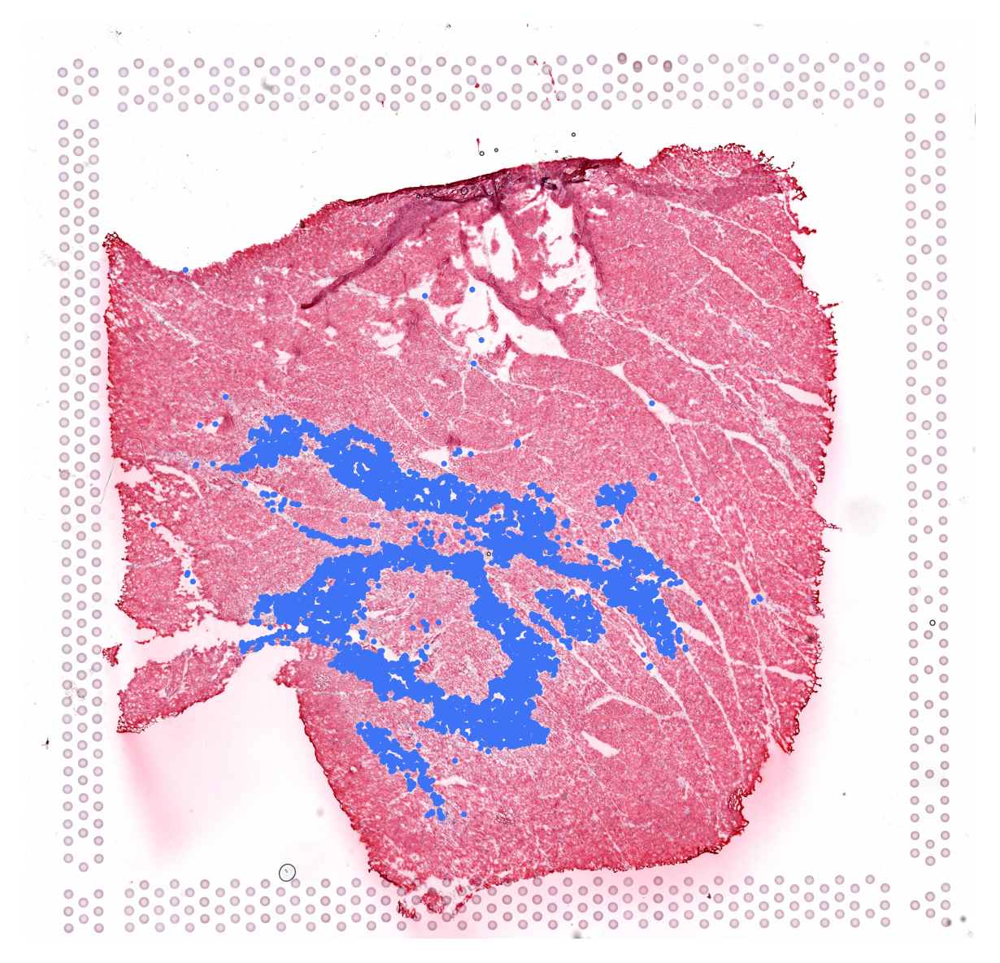

In [36]:
plot_heatmap(ad_select, im)

In [38]:
ad_select.write_h5ad('./data/HF/selected_regions/' + sn +'_all_roi.h5ad')

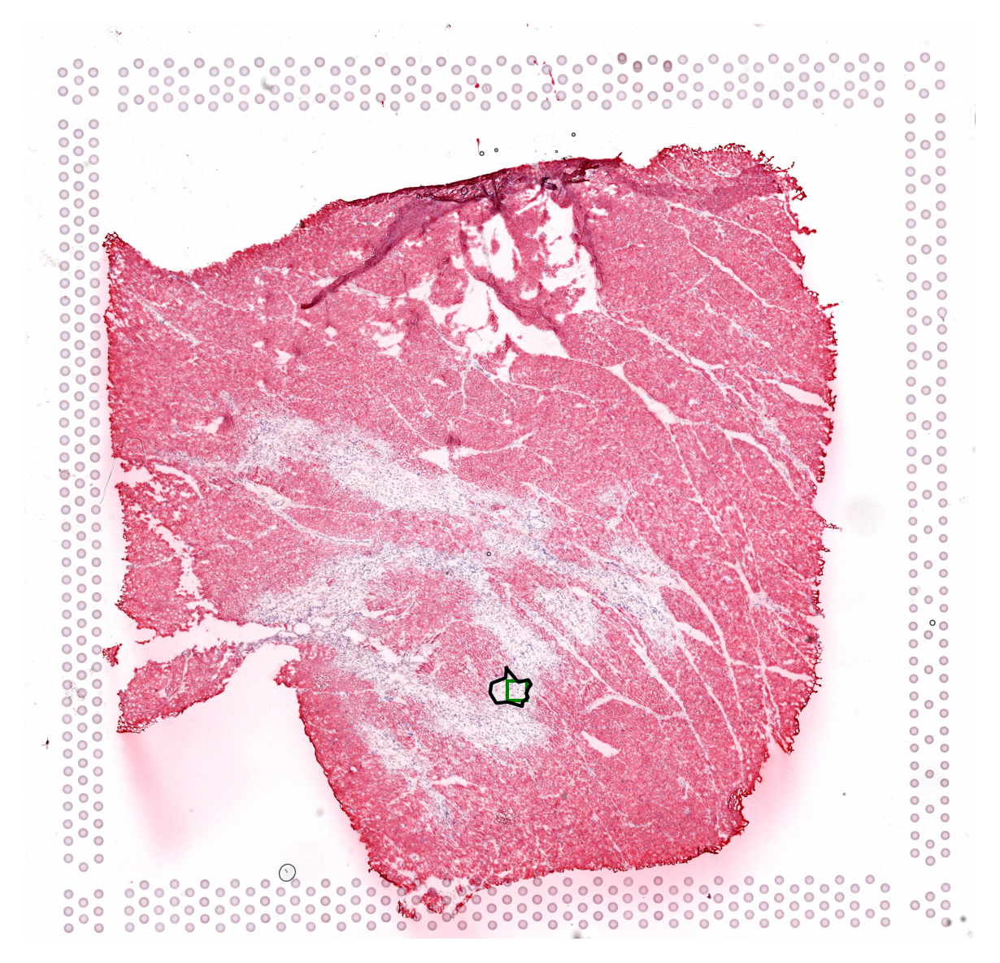

In [53]:
ROI_tuple = [5000, 6800, SIZE, SIZE]
plot_whole_img_with_box(sn, im, ROI_tuple)

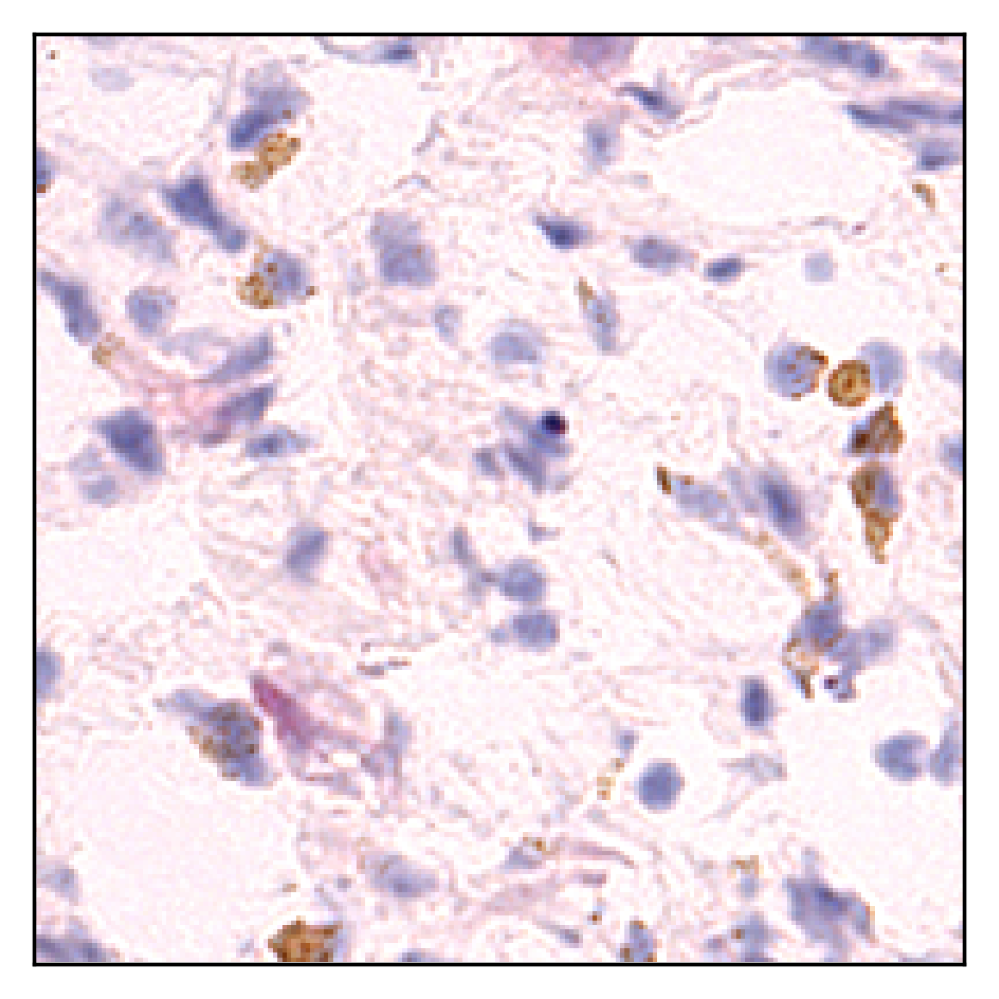

In [58]:
plot_he(ad, sn, im, regions, ROI_tuple)

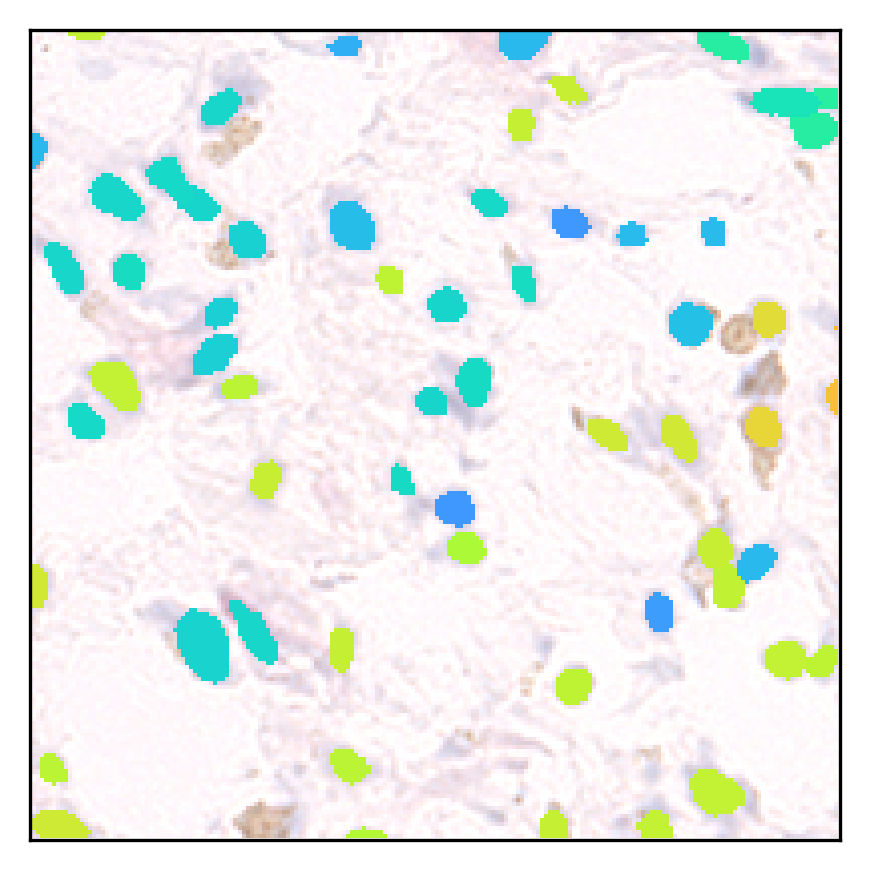

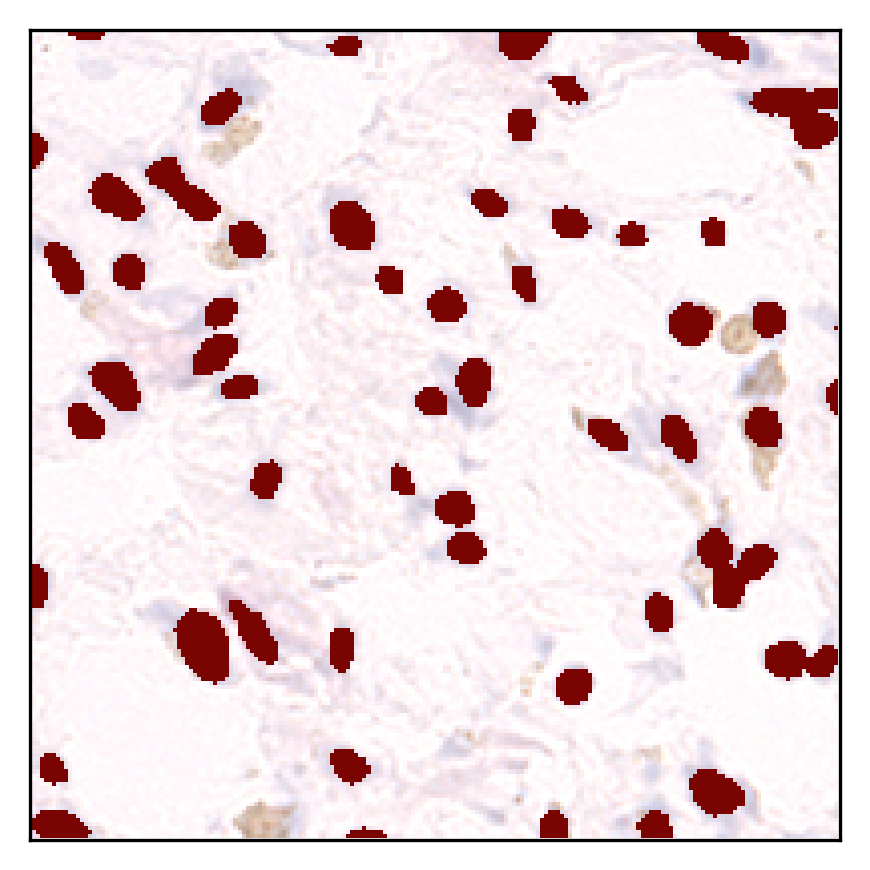

In [59]:
plot_gene(ad, sn, im, regions, ROI_tuple)

### RZ_P11

In [81]:
sn = 'RZ_P11'
ad, im, regions = read_data(sn)

In [82]:
ad = get_feature(sn)
ad

AnnData object with n_obs × n_vars = 17463 × 13483
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X_pca', 

In [83]:
corr_matrix = calc_corr(ad)

In [84]:
ad_ROI = sc.read_h5ad('./data/HF/selected_regions/' + sn +'_draw.h5ad')
ad_ROI

AnnData object with n_obs × n_vars = 159 × 13483
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title'
    obsm: 'X_pca', 'X_spatial', 'X_umap', 'spatial'
    obsp: 'snn_connectivities', 'snn_knn_connect

In [85]:
ad_select = select_cell(ad,ad_ROI,corr_matrix)
ad_select

View of AnnData object with n_obs × n_vars = 727 × 13483
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X_

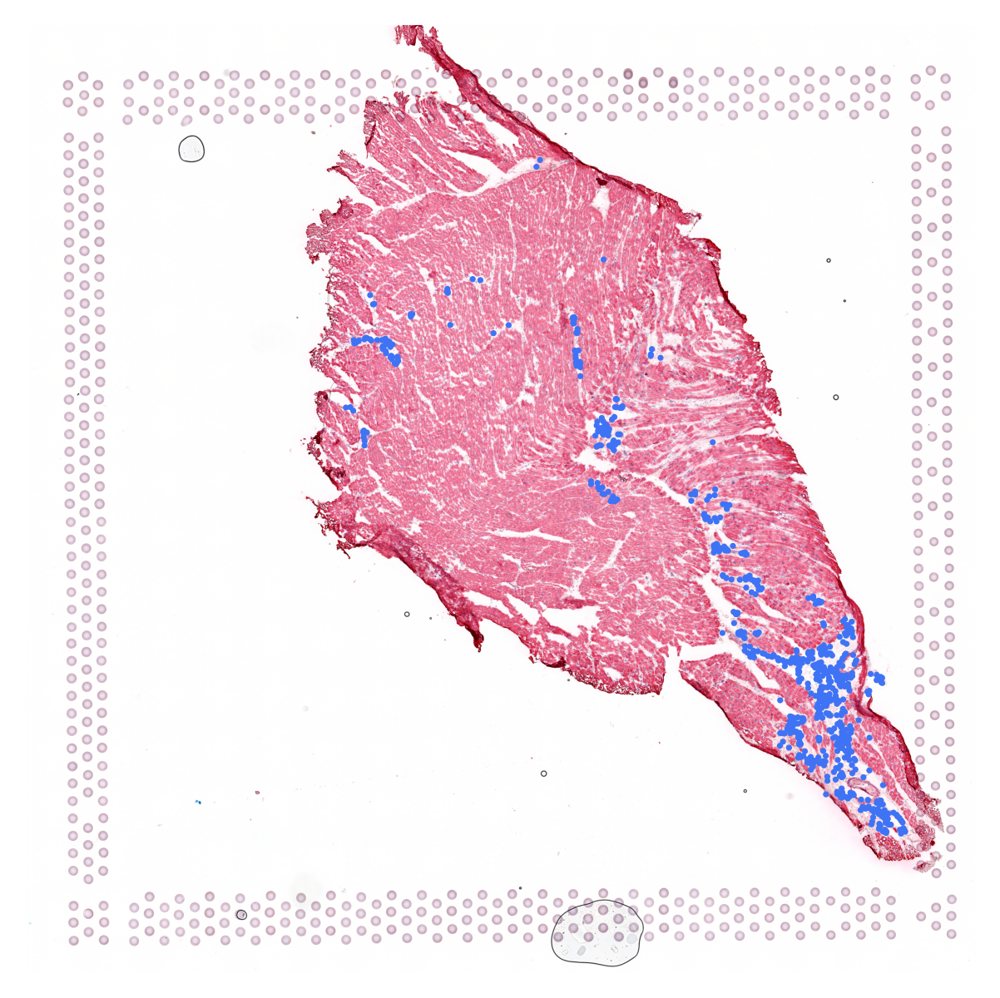

In [86]:
plot_heatmap(ad_select, im)

In [87]:
ad_select.write_h5ad('./data/HF/selected_regions/' + sn +'_all_roi.h5ad')

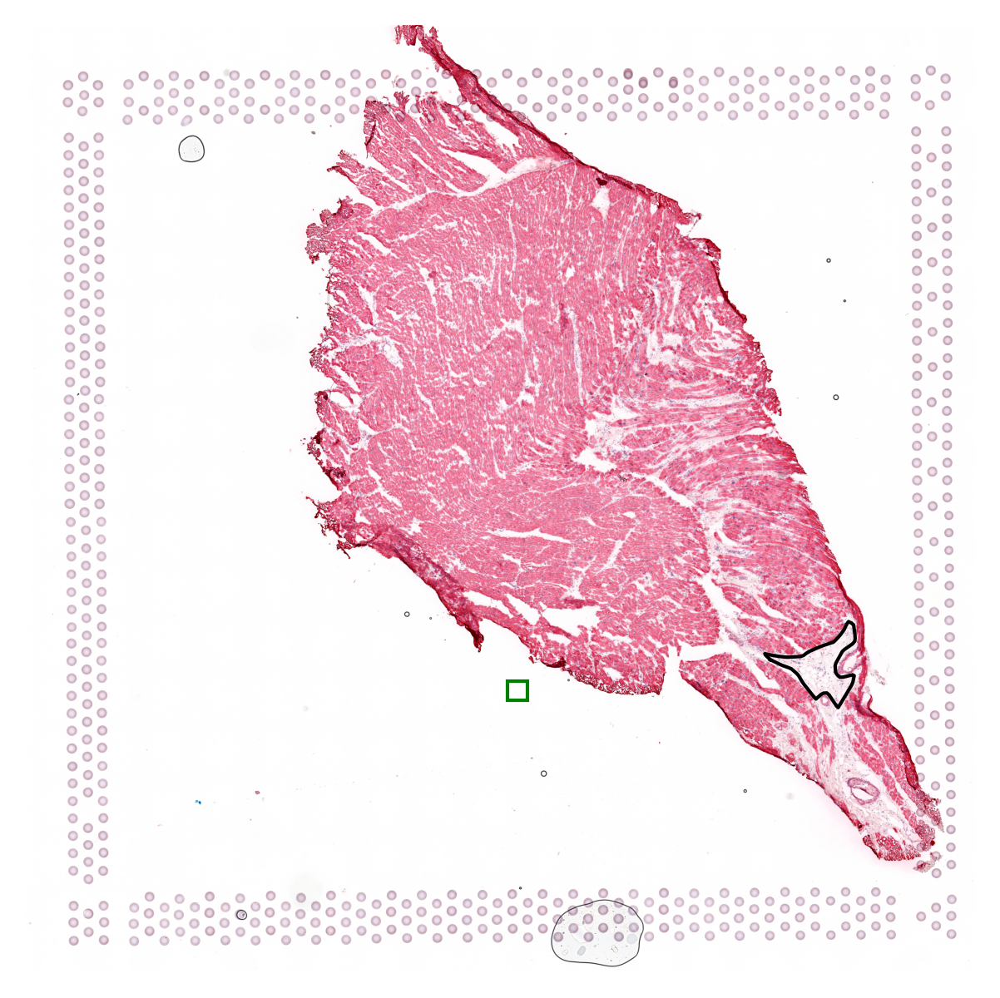

In [88]:
ROI_tuple = [5000, 6800, SIZE, SIZE]
plot_whole_img_with_box(sn, im, ROI_tuple)

### GT_IZ_P9

In [91]:
sn = 'GT_IZ_P9'
ad, im, regions = read_data(sn)

In [92]:
ad = get_feature(sn)
ad

AnnData object with n_obs × n_vars = 50424 × 15972
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X_pca', 

In [93]:
corr_matrix = calc_corr(ad)

In [94]:
ad_ROI = sc.read_h5ad('./data/HF/selected_regions/' + sn +'_draw.h5ad')
ad_ROI

AnnData object with n_obs × n_vars = 427 × 15972
    obs: 'n_counts', 'n_genes', 'percent.mt', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights'
    var: 'features'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title'
    obsm: 'X_pca', 'X_spatial', 'X_umap', 'spatial'
    obsp: 'snn_connectivities', 'snn_knn_connectivities', 'snn_transition_matrix'

In [95]:
ad_select = select_cell(ad,ad_ROI,corr_matrix)
ad_select

View of AnnData object with n_obs × n_vars = 6979 × 15972
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X

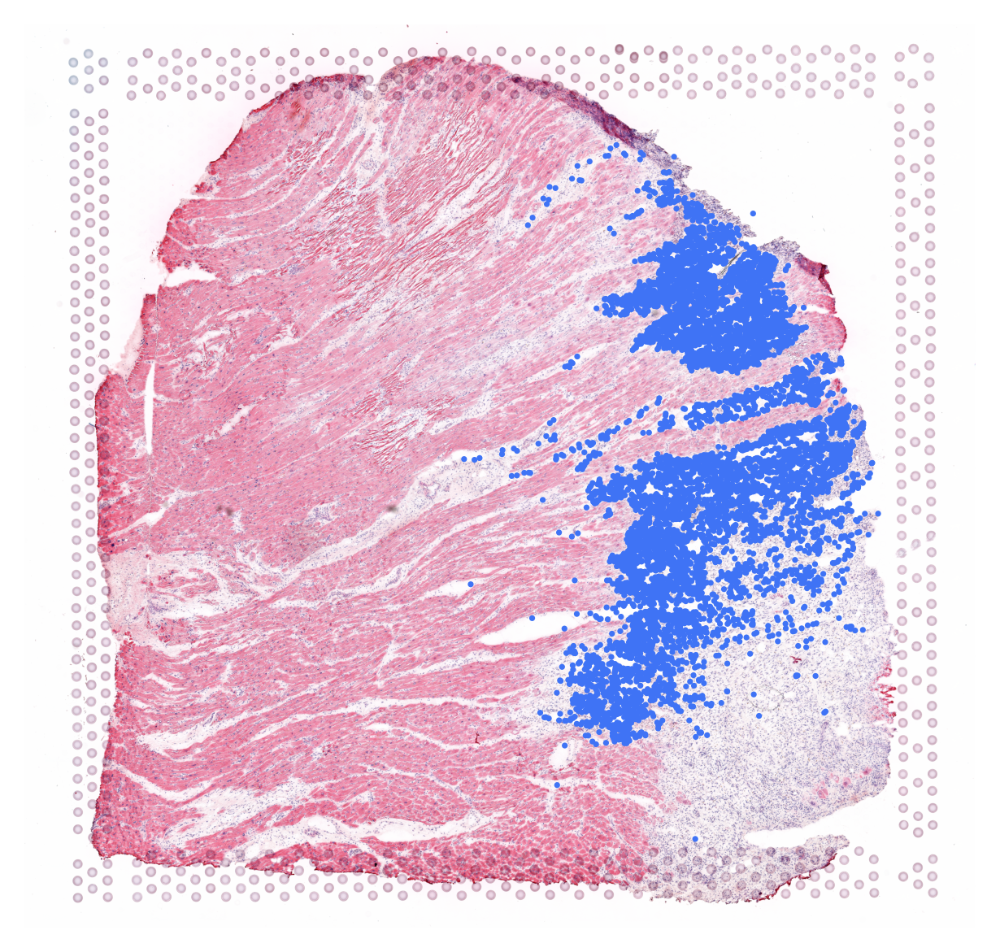

In [96]:
plot_heatmap(ad_select, im)

In [97]:
ad_select.write_h5ad('./data/HF/selected_regions/' + sn +'_all_roi.h5ad')

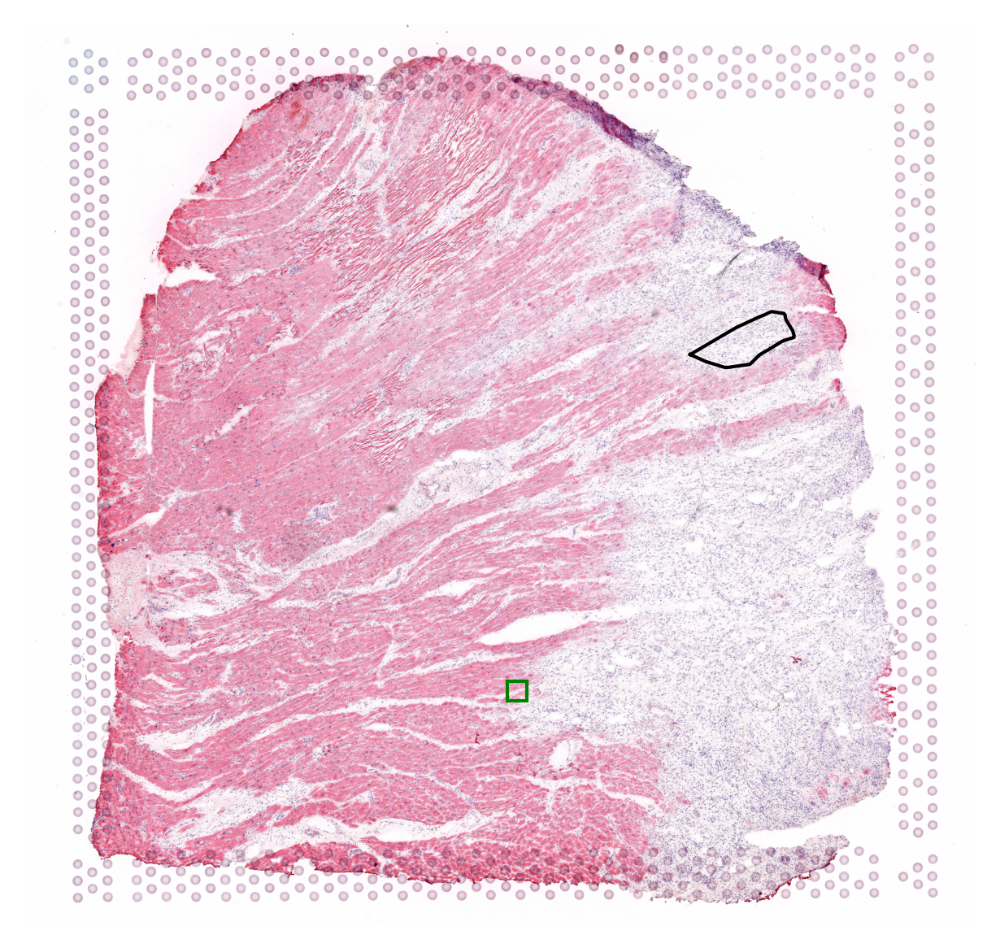

In [98]:
ROI_tuple = [5000, 6800, SIZE, SIZE]
plot_whole_img_with_box(sn, im, ROI_tuple)

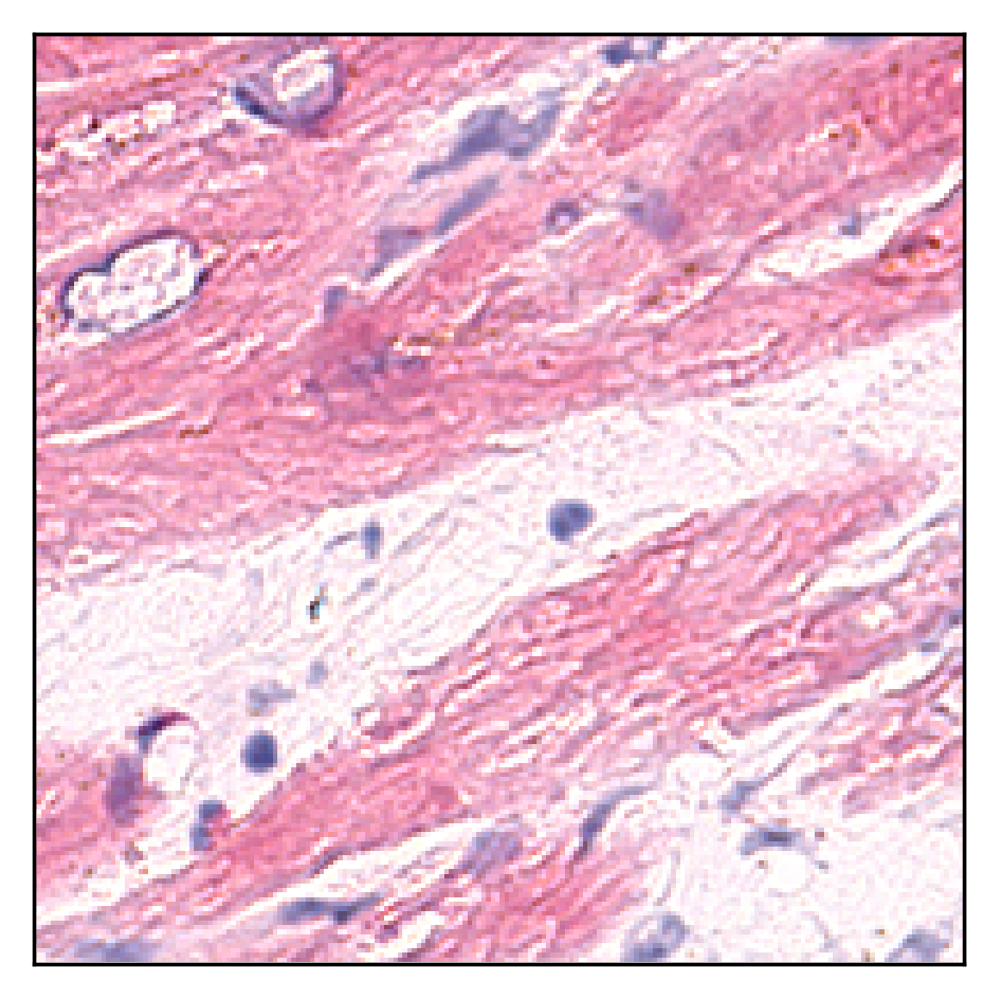

In [99]:
plot_he(ad, sn, im, regions, ROI_tuple)

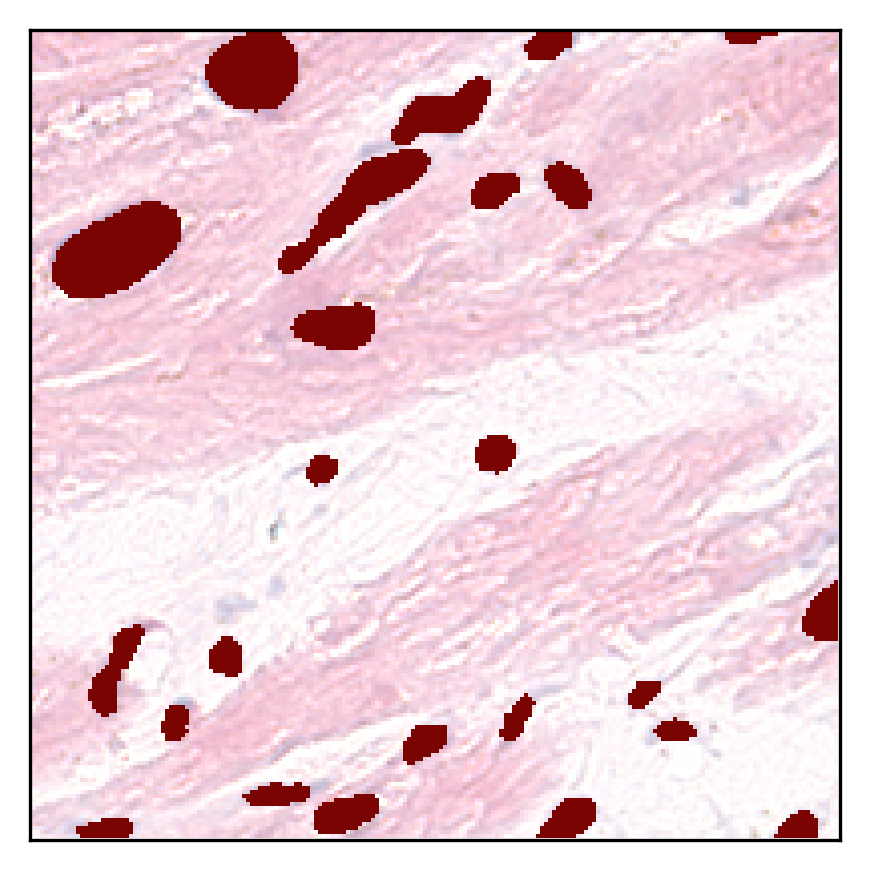

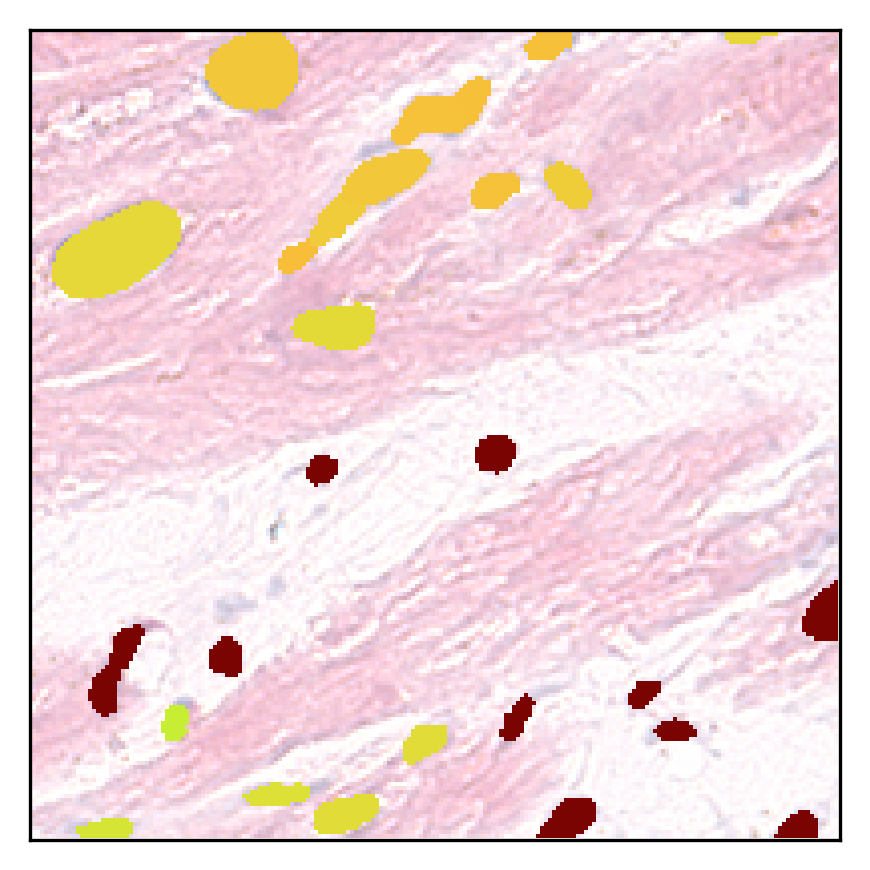

In [100]:
plot_gene(ad, sn, im, regions, ROI_tuple)

### IZ_P10

In [101]:
sn = 'IZ_P10'
ad, im, regions = read_data(sn)

In [102]:
ad = get_feature(sn)
ad

AnnData object with n_obs × n_vars = 26790 × 15679
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X_pca', 

In [103]:
corr_matrix = calc_corr(ad)

In [104]:
ad_ROI = sc.read_h5ad('./data/HF/selected_regions/' + sn +'_draw.h5ad')
ad_ROI

AnnData object with n_obs × n_vars = 66 × 15679
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title'
    obsm: 'X_pca', 'X_spatial', 'X_umap', 'spatial'
    obsp: 'snn_connectivities', 'snn_knn_connecti

In [105]:
ad_select = select_cell(ad,ad_ROI,corr_matrix)
ad_select

View of AnnData object with n_obs × n_vars = 1175 × 15679
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X

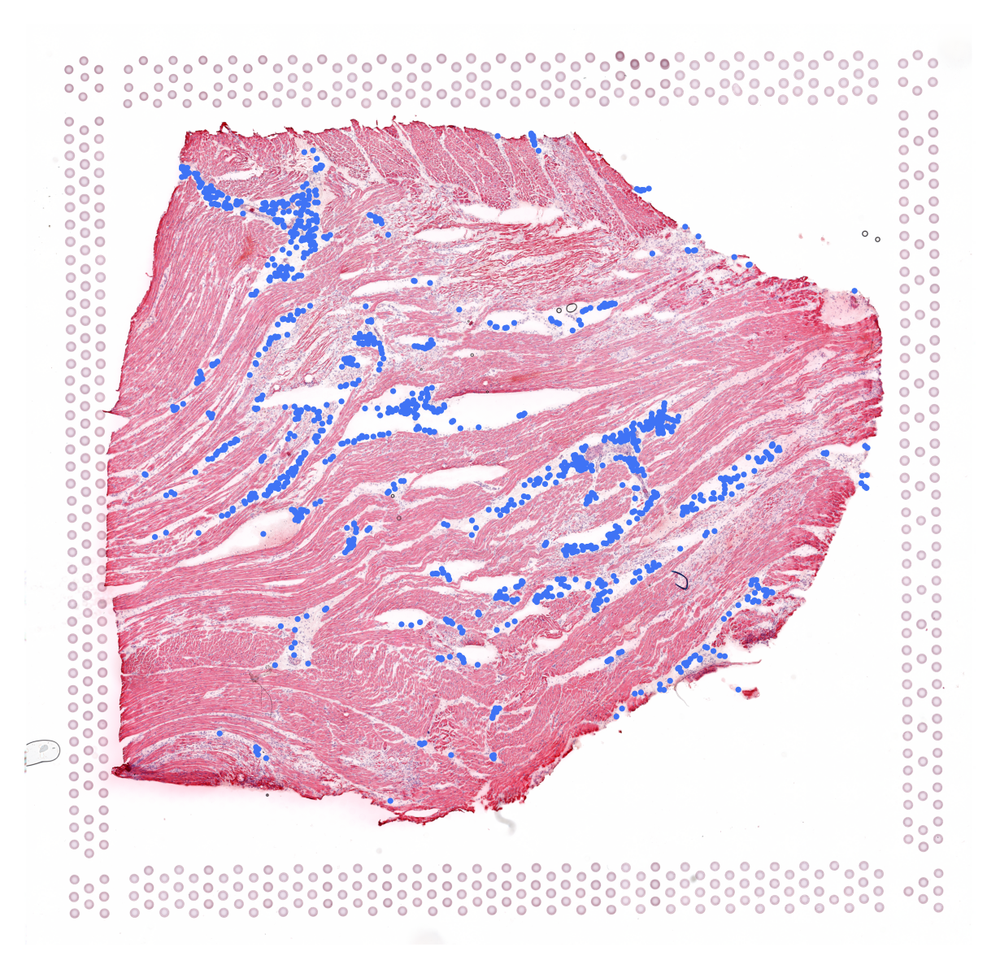

In [106]:
plot_heatmap(ad_select, im)

In [107]:
ad_select.write_h5ad('./data/HF/selected_regions/' + sn +'_all_roi.h5ad')

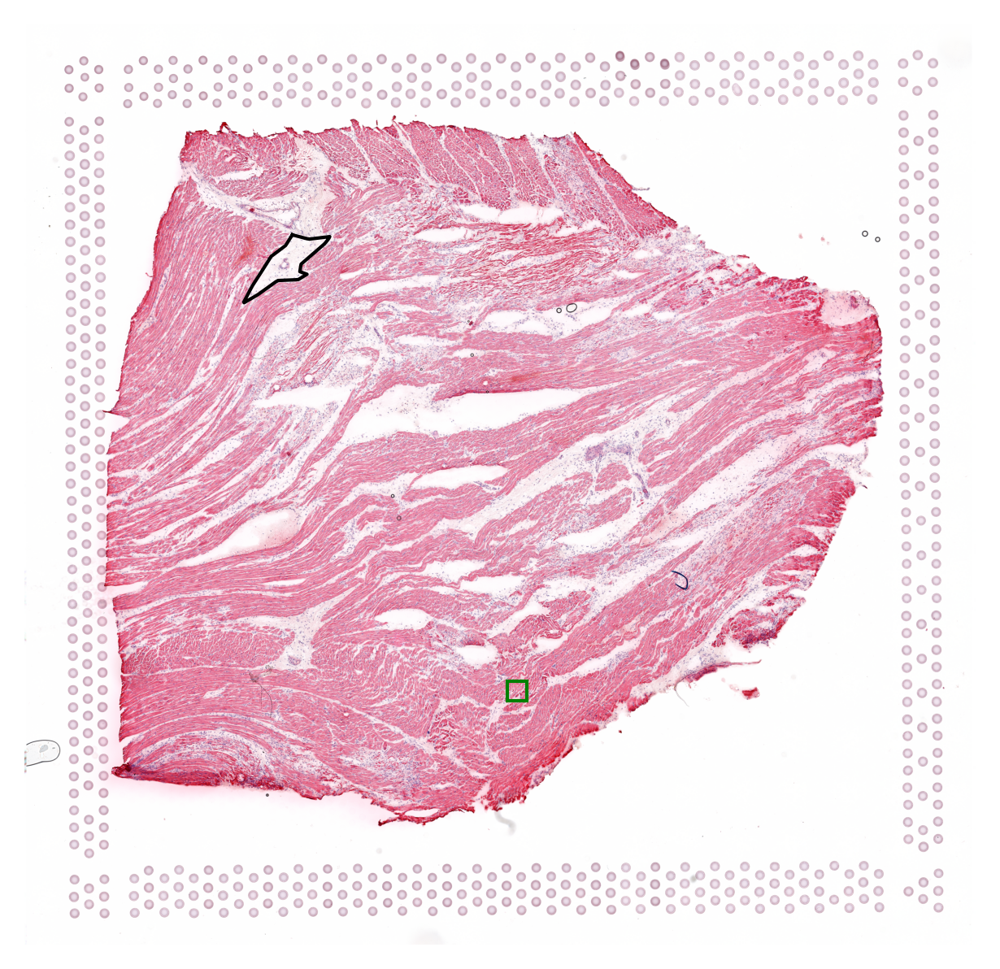

In [108]:
ROI_tuple = [5000, 6800, SIZE, SIZE]
plot_whole_img_with_box(sn, im, ROI_tuple)

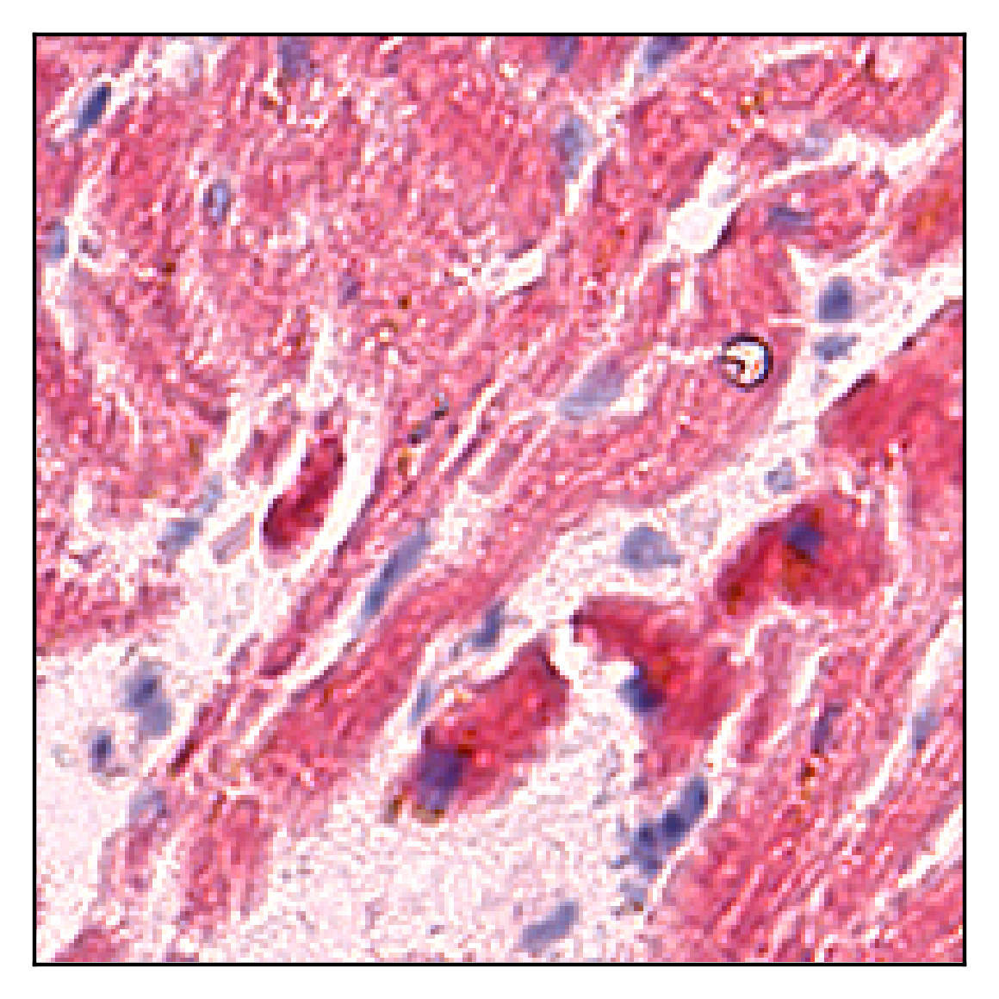

In [109]:
plot_he(ad, sn, im, regions, ROI_tuple)

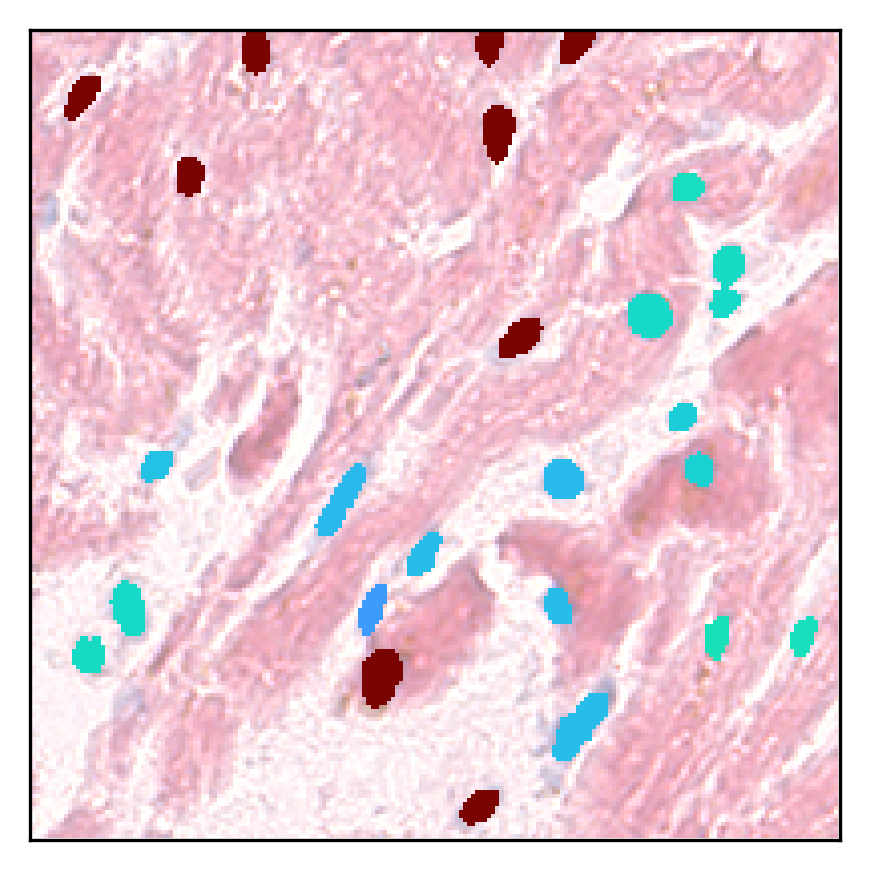

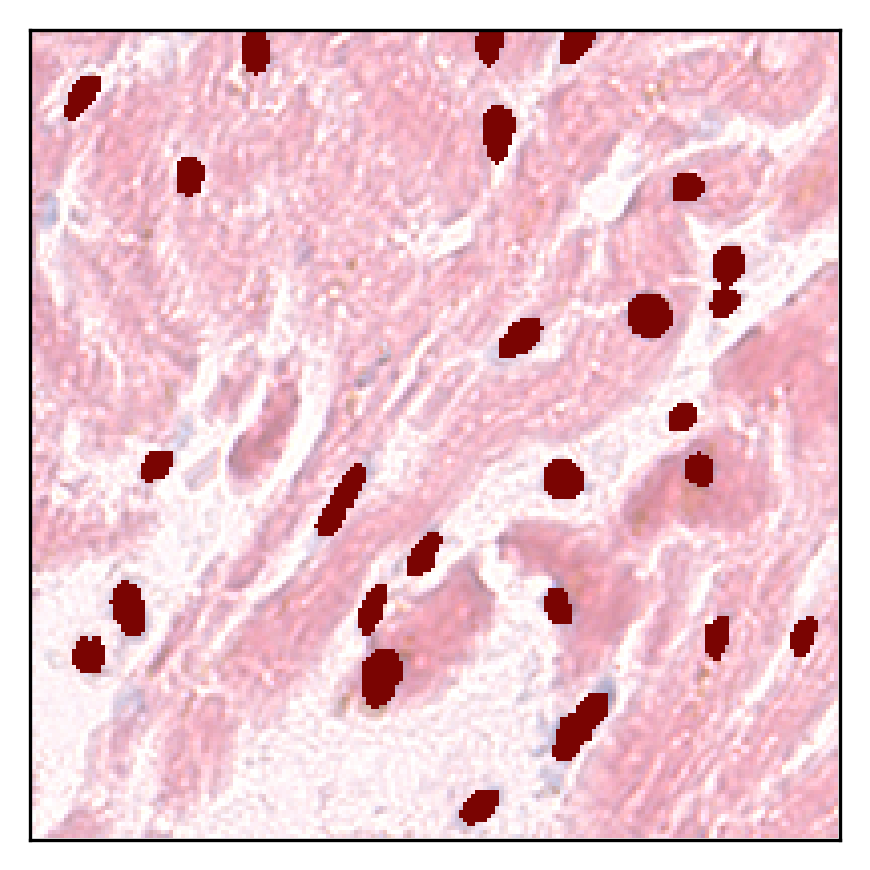

In [110]:
plot_gene(ad, sn, im, regions, ROI_tuple)

### FZ_GT_P19

In [111]:
sn = 'FZ_GT_P19'
ad, im, regions = read_data(sn)

In [112]:
ad = get_feature(sn)
ad

AnnData object with n_obs × n_vars = 27799 × 14097
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X_pca', 

In [113]:
corr_matrix = calc_corr(ad)

In [114]:
ad_ROI = sc.read_h5ad('./data/HF/selected_regions/' + sn +'_draw.h5ad')
ad_ROI

AnnData object with n_obs × n_vars = 360 × 14097
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title'
    obsm: 'X_pca', 'X_spatial', 'X_umap', 'spatial'
    obsp: 'snn_connectivities', 'snn_knn_connect

In [115]:
ad_select = select_cell(ad,ad_ROI,corr_matrix)
ad_select

View of AnnData object with n_obs × n_vars = 6050 × 14097
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X

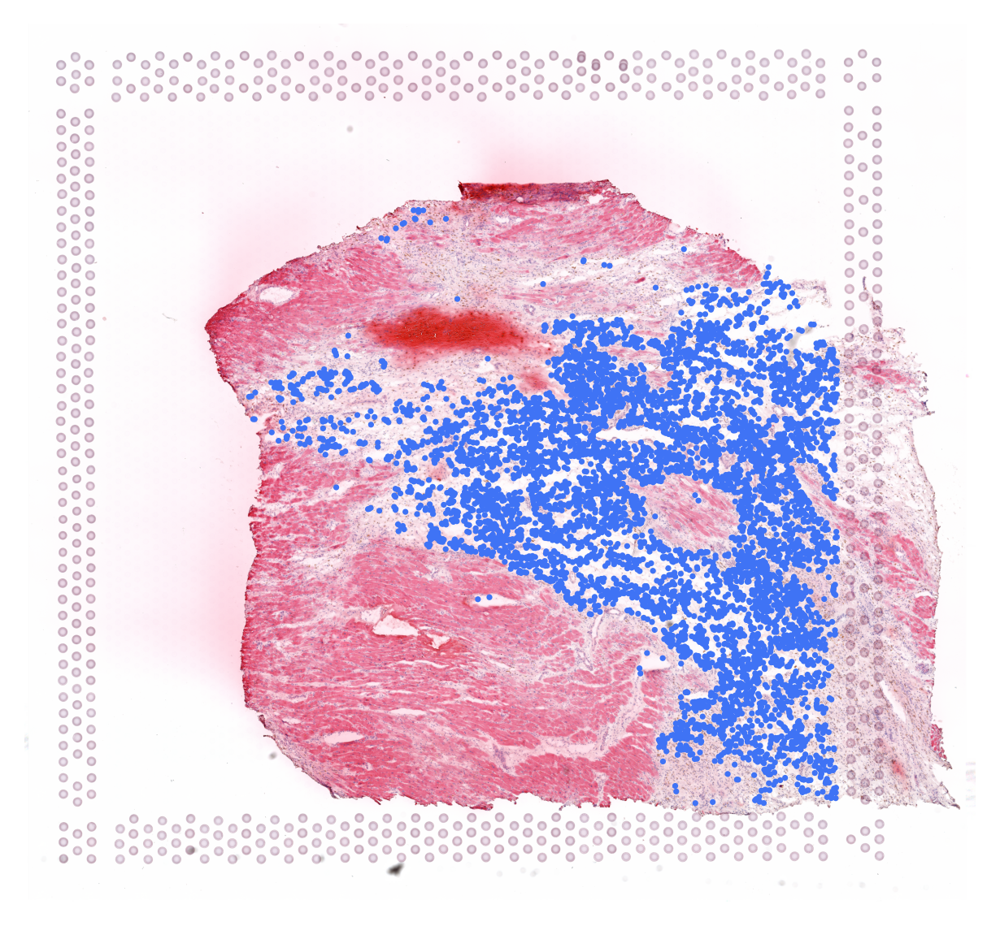

In [116]:
plot_heatmap(ad_select, im)

In [117]:
ad_select.write_h5ad('./data/HF/selected_regions/' + sn +'_all_roi.h5ad')

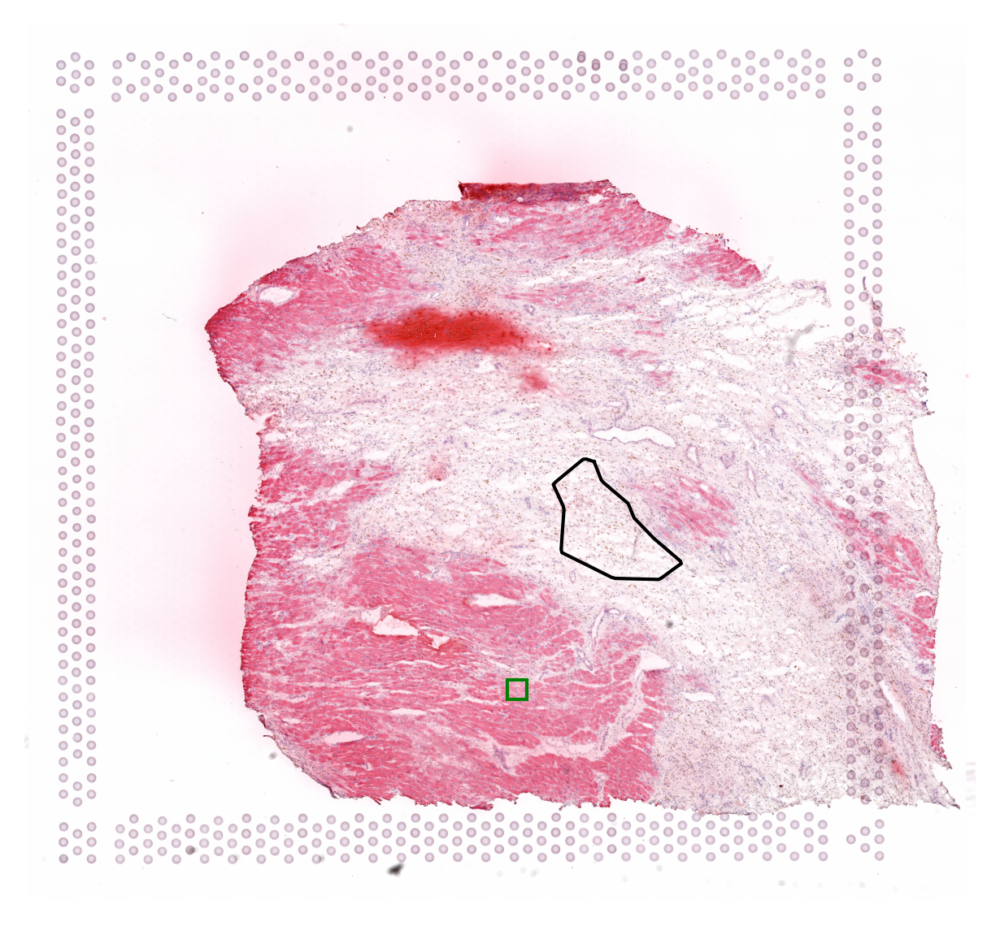

In [118]:
ROI_tuple = [5000, 6800, SIZE, SIZE]
plot_whole_img_with_box(sn, im, ROI_tuple)

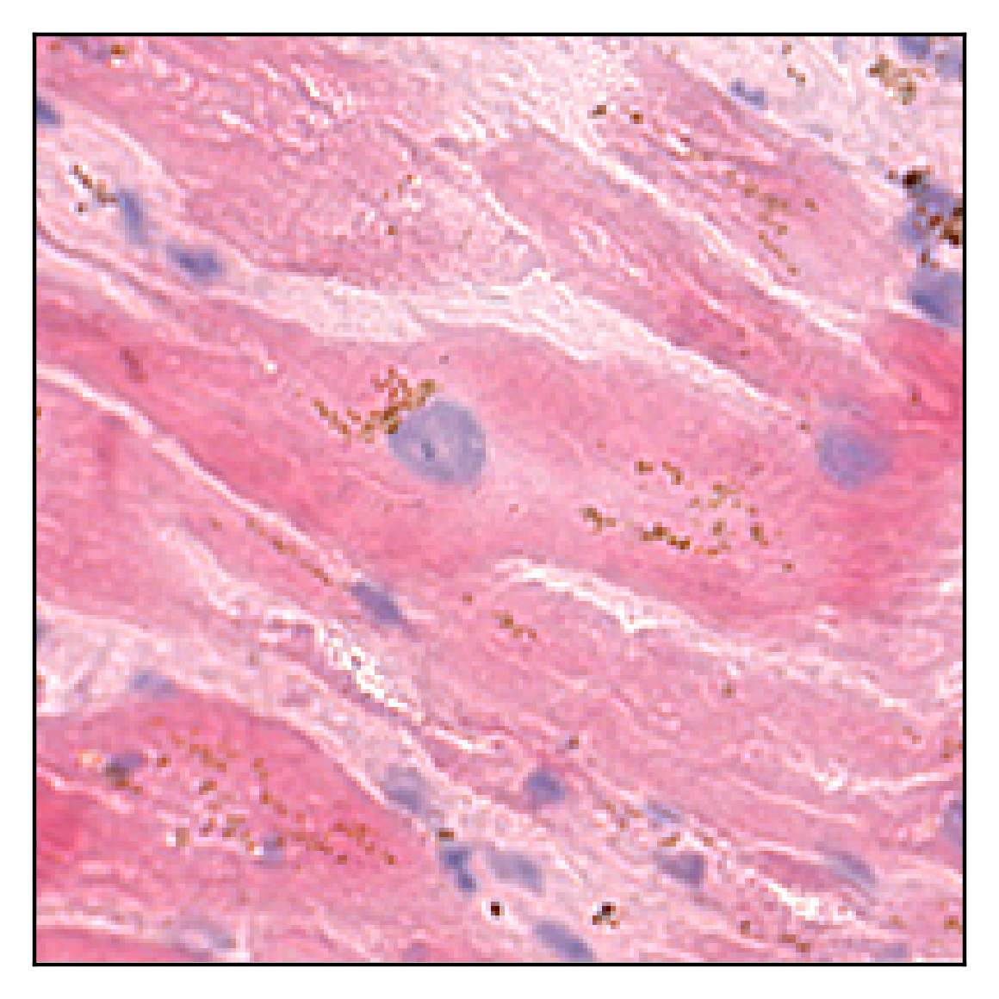

In [119]:
plot_he(ad, sn, im, regions, ROI_tuple)

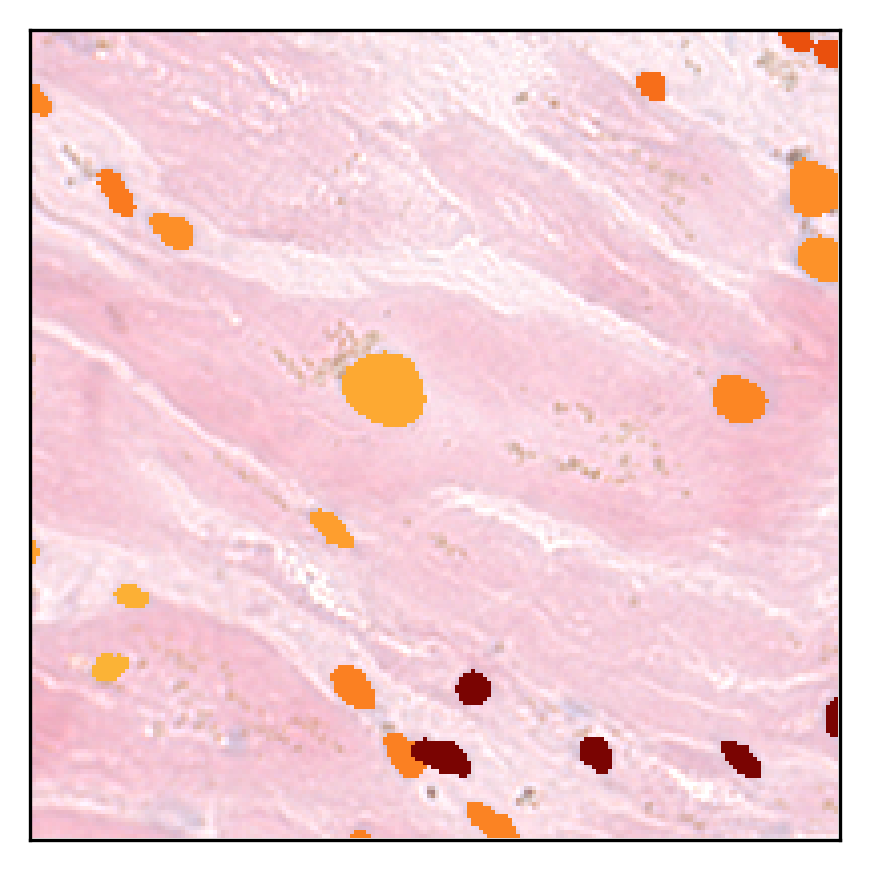

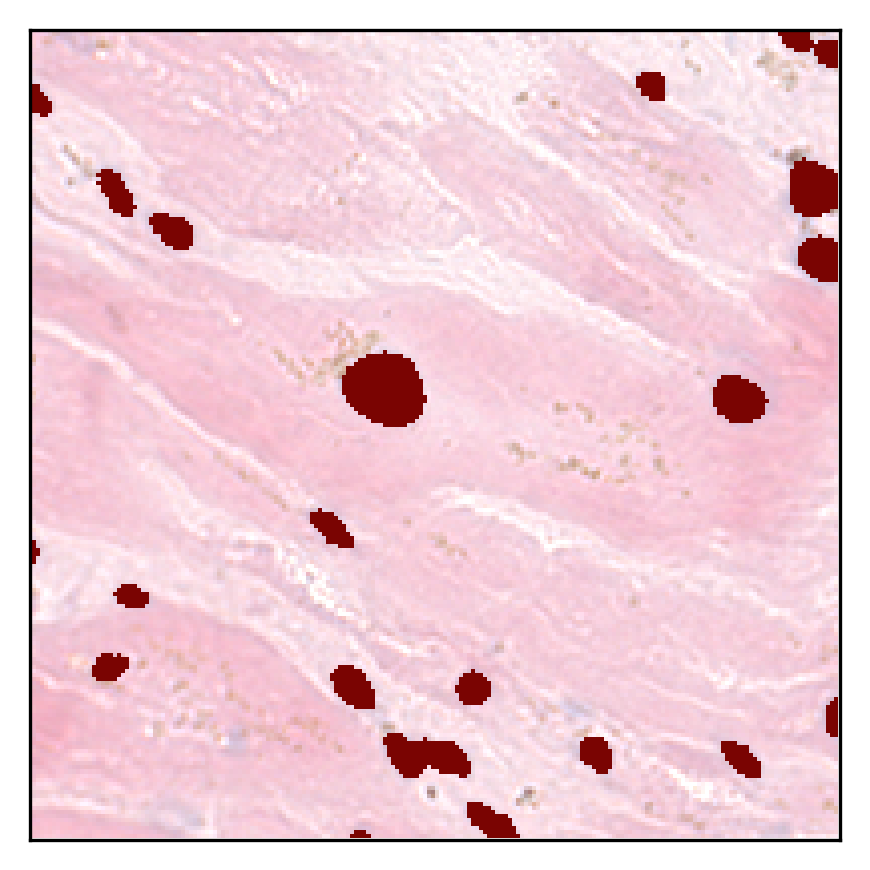

In [120]:
plot_gene(ad, sn, im, regions, ROI_tuple)

### FZ_P18

In [121]:
sn = 'FZ_P18'
ad, im, regions = read_data(sn)

In [122]:
ad = get_feature(sn)
ad

AnnData object with n_obs × n_vars = 24215 × 13490
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X_pca', 

In [123]:
corr_matrix = calc_corr(ad)

In [124]:
ad_ROI = sc.read_h5ad('./data/HF/selected_regions/' + sn +'_draw.h5ad')
ad_ROI

AnnData object with n_obs × n_vars = 141 × 13490
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title'
    obsm: 'X_pca', 'X_spatial', 'X_umap', 'spatial'
    obsp: 'snn_connectivities', 'snn_knn_connect

In [125]:
ad_select = select_cell(ad,ad_ROI,corr_matrix)
ad_select

View of AnnData object with n_obs × n_vars = 1148 × 13490
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'hist_PC1', 'hist_PC2', 'hist_PC3', 'expr_PC1', 'expr_PC2', 'expr_PC3'
    var: 'features', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'X_approximate_distribution', 'X_normalization', 'cell_image_props', 'default_embedding', 'log1p', 'schema_version', 'snn', 'spatial', 'title', 'pca'
    obsm: 'X

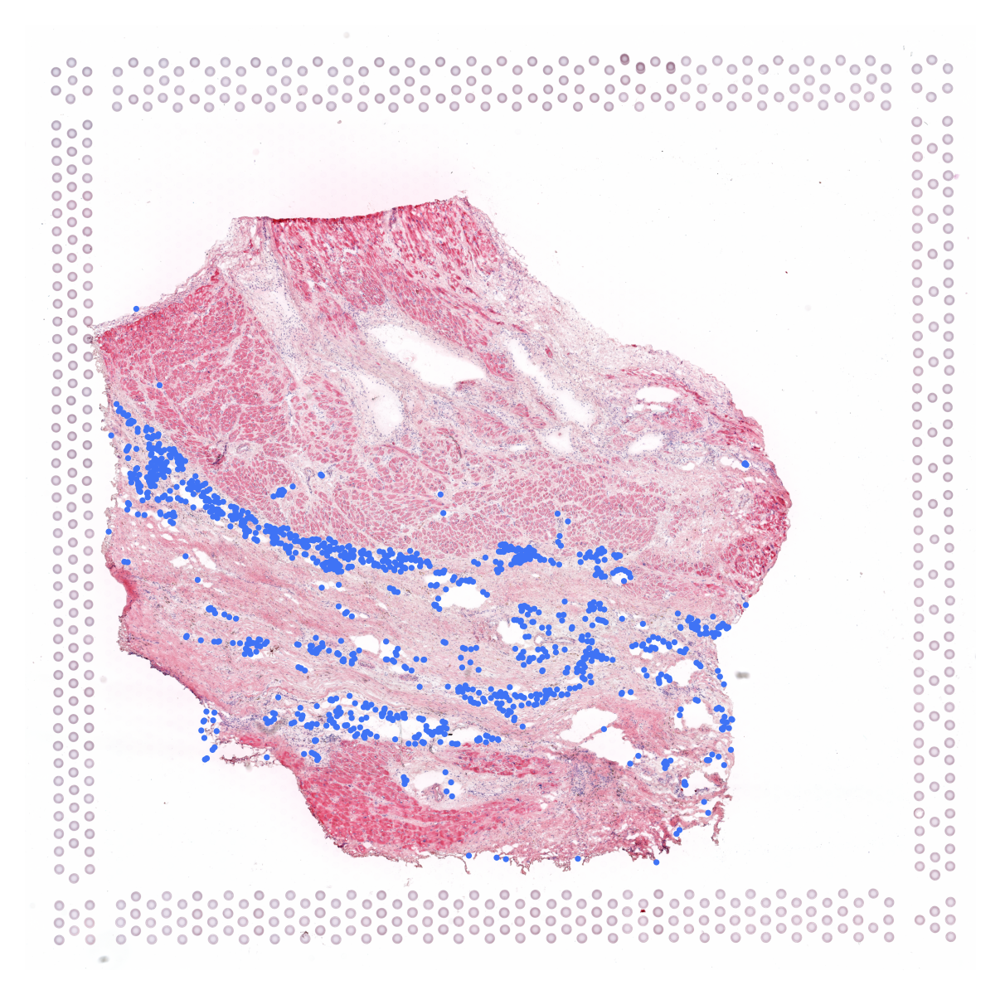

In [126]:
plot_heatmap(ad_select, im)

In [127]:
ad_select.write_h5ad('./data/HF/selected_regions/' + sn +'_all_roi.h5ad')

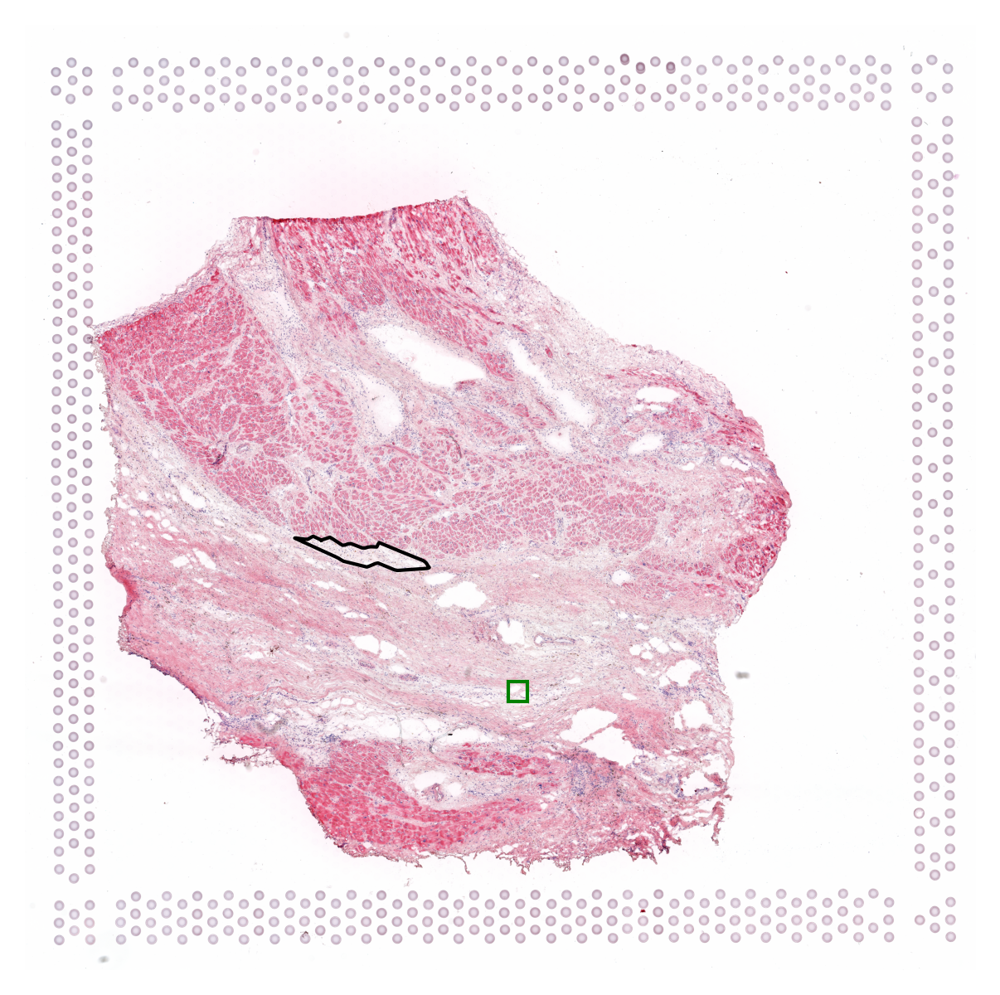

In [128]:
ROI_tuple = [5000, 6800, SIZE, SIZE]
plot_whole_img_with_box(sn, im, ROI_tuple)

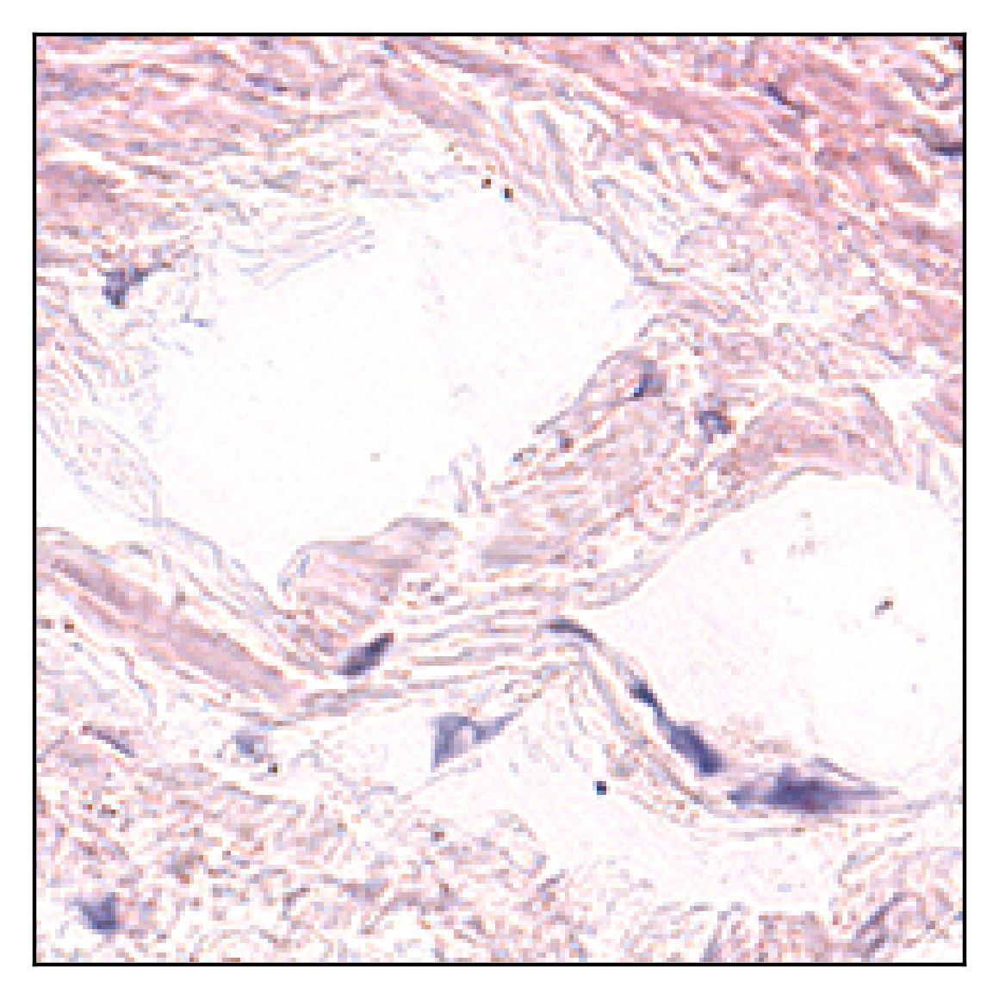

In [129]:
plot_he(ad, sn, im, regions, ROI_tuple)

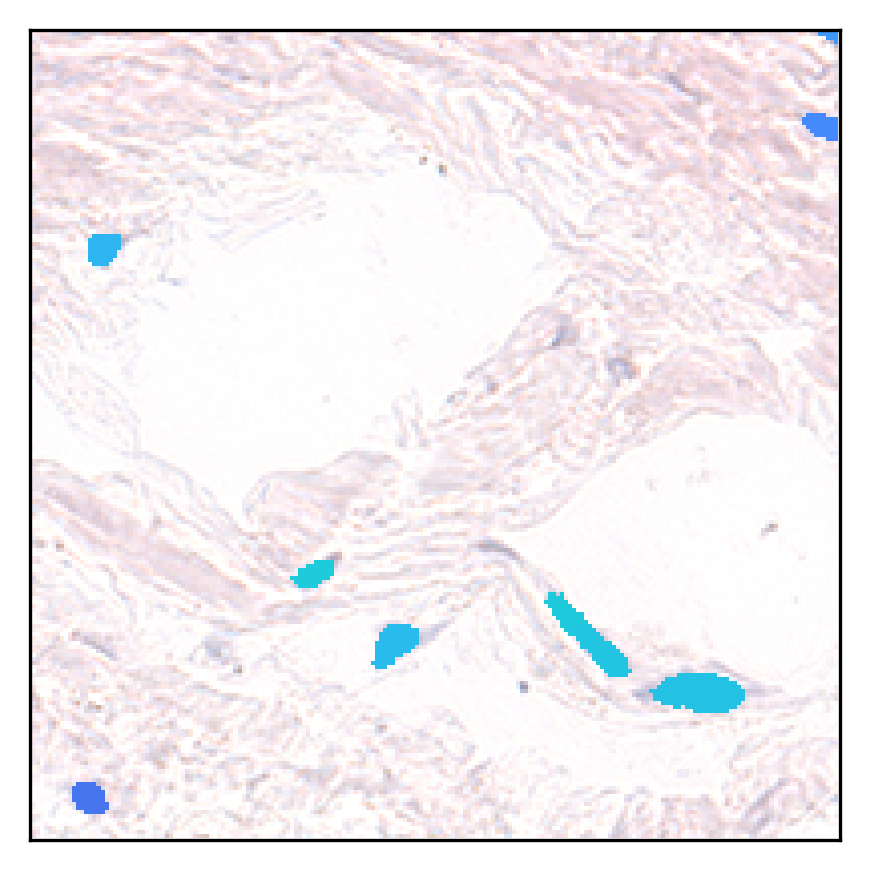

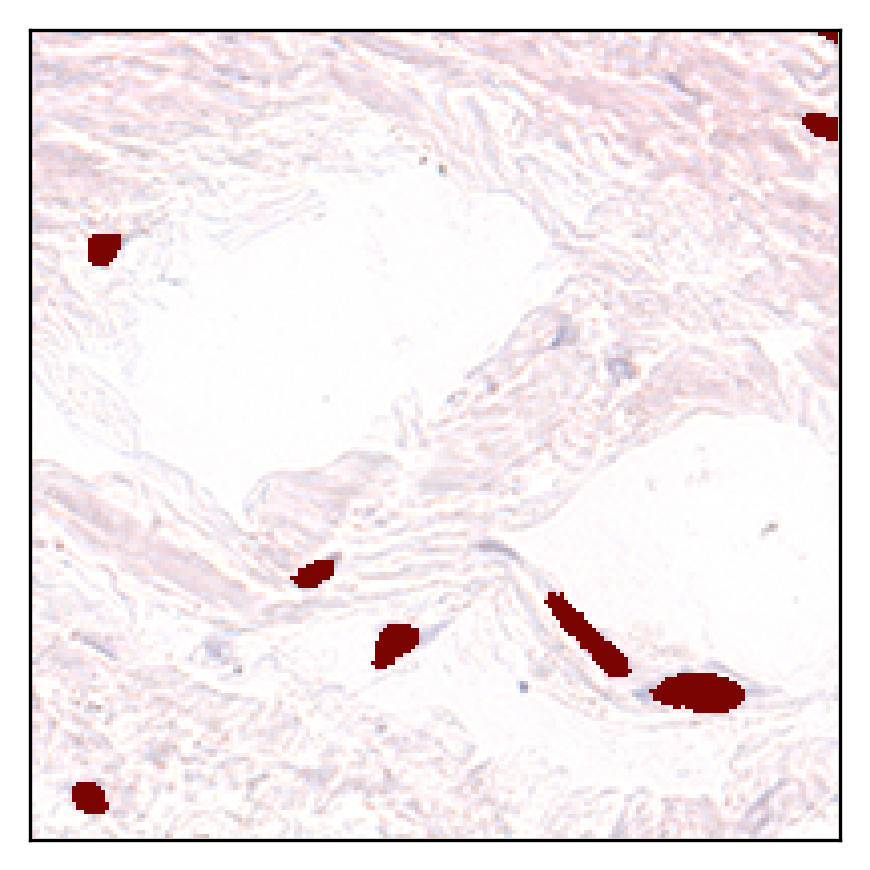

In [130]:
plot_gene(ad, sn, im, regions, ROI_tuple)

## Get the proportion of SSA-identified fibrotic regions

In [131]:
samples = ['RZ_GT_P2', 'RZ_P11', 'GT_IZ_P9', 'IZ_P10', 'FZ_GT_P19', 'FZ_P18']

In [ ]:
df = pd.DataFrame()
for sn in samples:

    ad = sc.read_h5ad('./data/HF/results_n5_g1_allgenes_prob/' + sn +'/'+ sn+'_fineST_20.h5ad')
    ad_roi = sc.read_h5ad('./data/HF/selected_regions/' + sn +'_all_roi.h5ad')

    ad_num_spot = len(ad.obs['spot_barcodes'].unique())
    ad_roi_num_spot = len(ad_roi.obs['spot_barcodes'].unique())

    df.loc[sn,'percentage_spot'] = ad_roi_num_spot/ad_num_spot

In [134]:
df['type'] = ['RZ','RZ','IZ','IZ','FZ','FZ']
df

,percentage_spot,type
RZ_GT_P2,0.180295,RZ
RZ_P11,0.095713,RZ
GT_IZ_P9,0.205423,IZ
IZ_P10,0.119944,IZ
FZ_GT_P19,0.413220,FZ
FZ_P18,0.159507,FZ


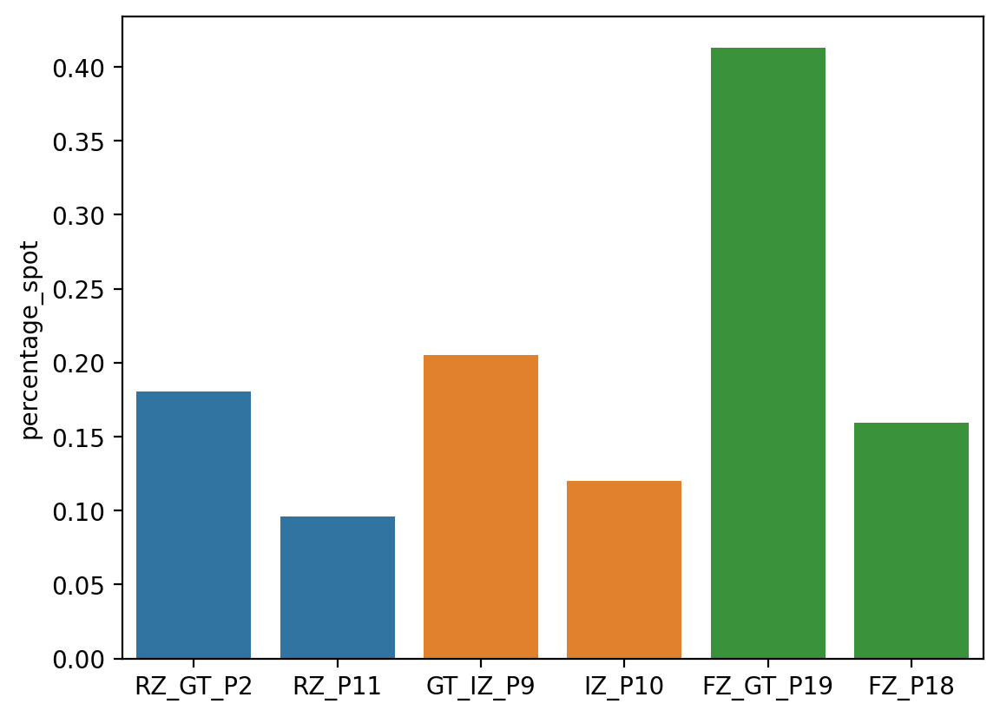

In [143]:
sns.barplot(df, x= df.index, y = 'percentage_spot',hue='type',dodge=False)
plt.rcParams.update(plt.rcParamsDefault)
plt.legend([],[], frameon=False)